In [1]:
!pip install scanpy

In [2]:
!pip install squidpy

In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import squidpy as sq
from scipy.cluster import hierarchy as sch
from matplotlib import pyplot as plt
from copy import deepcopy
from pathlib import Path
%matplotlib inline

/usr/local/lib/python3.10/dist-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()


In [4]:
# Load MERFISH Data

from google.colab import drive
drive.mount('/content/drive')
vizgen_dir = Path().resolve() / "drive" / "MyDrive" / "stage_M2_CRCT"

adata = sq.read.vizgen(
               vizgen_dir,
               counts_file='HumanOvarianCancerPatient2Slice2_cell_by_gene.csv',
               meta_file='HumanOvarianCancerPatient2Slice2_cell_metadata.csv'
)
len(adata)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


71381

In [5]:
# Make gene names unique and calculate QC metrics
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("mt-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"],percent_top=(50, 100, 200, 300), inplace=True)
adata

AnnData object with n_obs × n_vars = 71381 × 500
    obs: 'fov', 'volume', 'min_x', 'max_x', 'min_y', 'max_y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_300_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'blank_genes', 'spatial'

In [6]:
# Filter cells with low expression and genes that are expressed in too few cells
sc.pp.filter_cells(adata, min_counts=50)
sc.pp.filter_genes(adata, min_cells=10)

64584

In [7]:
# Data Pre-processing
print('normalize total')
sc.pp.normalize_total(adata)
print('log transform')
sc.pp.log1p(adata)
print('scale')
sc.pp.scale(adata, max_value=10)

normalize total
log transform
scale


In [8]:
# Dimensionality Reduction, Neighbor Calculation, and Clustering
resolution = 1.5
print('PCA')
sc.tl.pca(adata, svd_solver='arpack')
print('neighbors')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
print('UMAP')
sc.tl.umap(adata)
print('Leiden')
sc.tl.leiden(adata, resolution=resolution)

PCA
neighbors


In [ ]:
# !pip install llvmlite

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


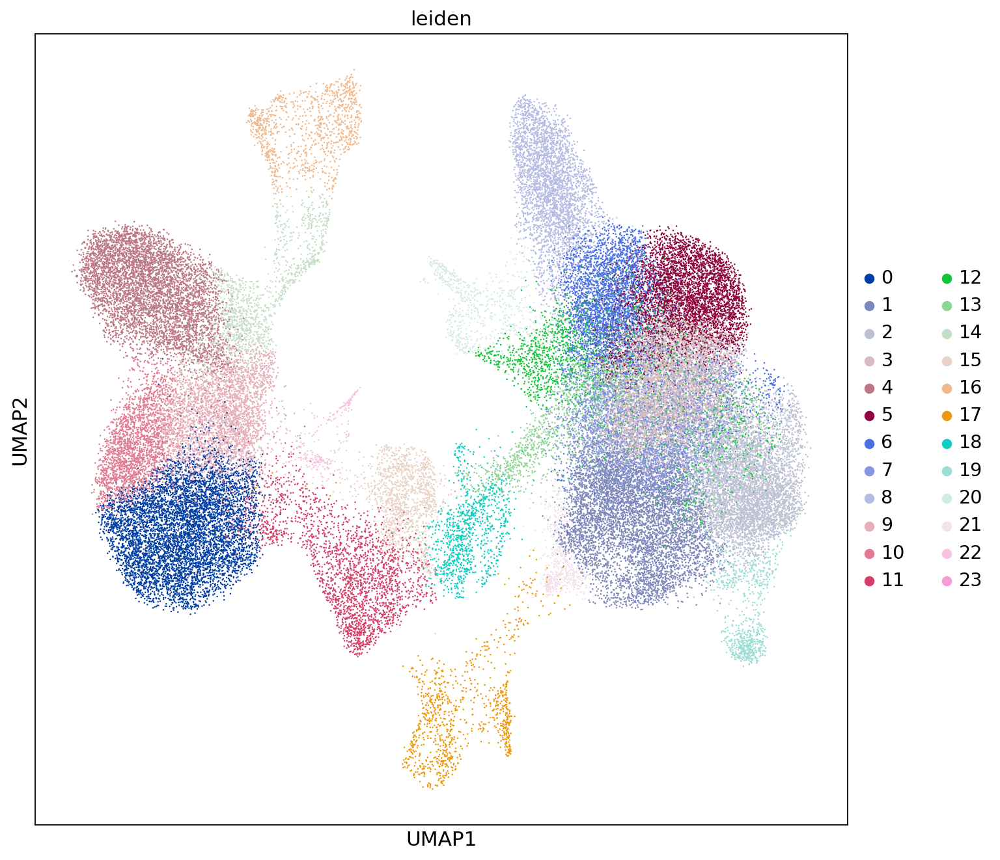

In [12]:
# UMAP with Leiden Clustering Labels
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(adata, color=['leiden'], size=5)

In [13]:
mARN_df = pd.read_csv('/content/drive/MyDrive/stage_M2_CRCT/HumanOvarianCancerPatient2Slice2_cell_by_gene.csv')

In [40]:
# for each gene, take the cell which have more than the average gene of all cells (mean_gene)
list_genes_chosen = ['CD4', 'LAG3', 'GZMB', 'HAVCR2', 'CD8A', 'MYC', 'TIGIT', 'CD8B', 'VSIR', 'CD163', 'CD226', 'CD68', 'COL1A1', 'LRP1', 'DUSP1', 'BST2', 'STAT6', 'JUNB', 'CEBPB', 'FOS', 'PKM']

for gene in list_genes_chosen:
  max_gene = mARN_df[gene].max()
  mean_gene = mARN_df[gene].mean()
  gene_expression = mARN_df[mARN_df[gene] > mean_gene].index
  color_gene = ['expressed' if index in gene_expression else 'non expressed' for index in adata.obs.index.astype(int)]
  adata.obs[gene+"_expression"] = color_gene

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

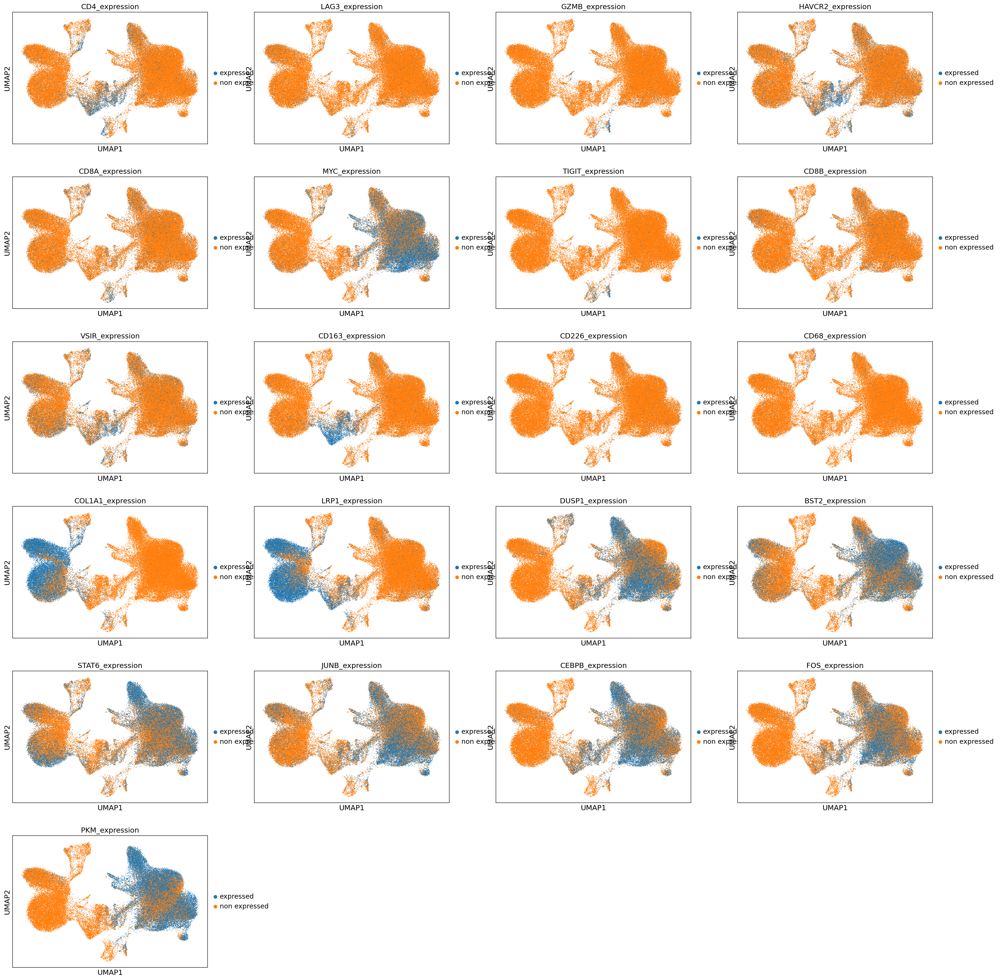

In [39]:
# UMAP with each gene expression
sc.set_figure_params(figsize=(7,5))
sc.pl.umap(adata, color=[gene+"_expression" for gene in list_genes_chosen], size=5)

/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


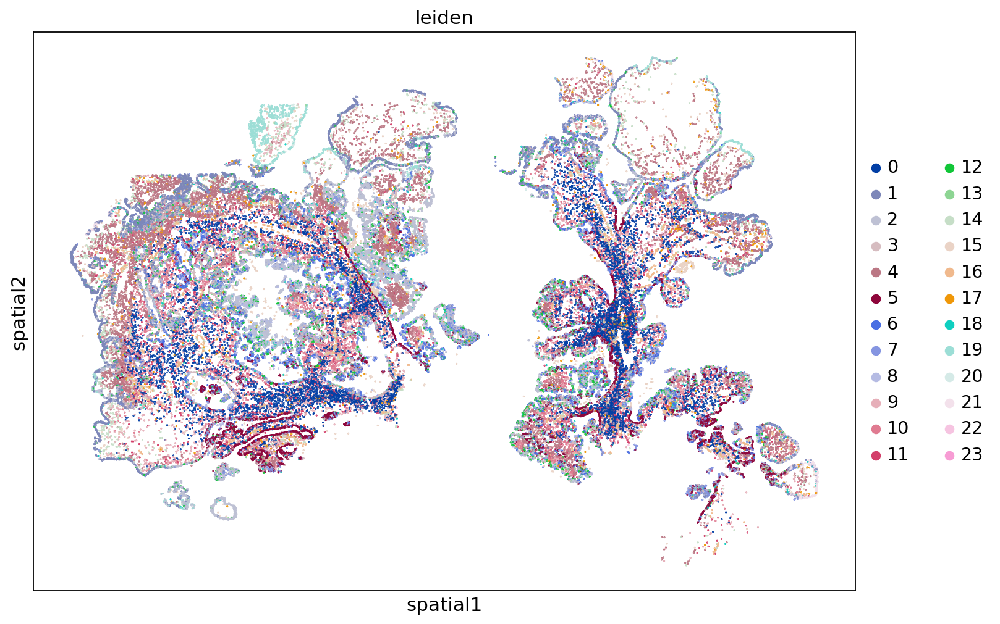

In [43]:
# Spatial Distributions of Cells
# Spatial space doesn't work at local jupyter notebook but it works with google colab
sq.pl.spatial_scatter(
    adata,
    shape=None,
    color='leiden',
    size=0.5,
    library_id='spatial',
    figsize=(10, 10)
)

/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/usr/local/lib/python3.10/dist-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/usr/local/lib/python3.10/dist-packages/squidpy/pl

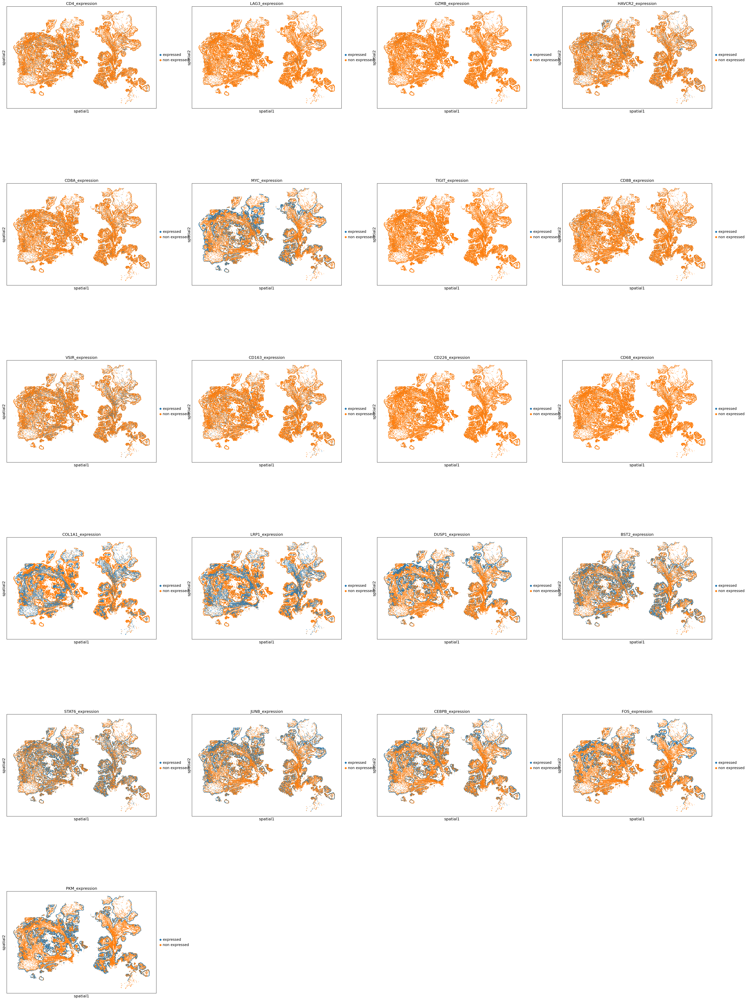

In [42]:
# Spatial Distributions of Cells with each gene expression
sq.pl.spatial_scatter(
    adata,
    shape=None,
    color=[gene+"_expression" for gene in list_genes_chosen],
    size=0.5,
    library_id='spatial',
    figsize=(10, 10)
)

In [ ]:
# gene_panel = "https://static-content.springer.com/esm/art%3A10.1038%2Fs41421-021-00266-1/MediaObjects/41421_2021_266_MOESM1_ESM.xlsx"
# df_ref_panel_ini = pd.read_excel(gene_panel, index_col=0)
# df_ref_panel = df_ref_panel_ini.iloc[1:, :1]
# df_ref_panel.index.name = None
# df_ref_panel.columns = ["Function"]

# # Assign marker gene metadata using reference dataset
# marker_genes = df_ref_panel[
#     df_ref_panel["Function"].str.contains("marker")
# ].index.tolist()

# meta_gene = deepcopy(adata.var)
# common_marker_genes = list(set(meta_gene.index.tolist()).intersection(marker_genes))
# meta_gene.loc[common_marker_genes, "Markers"] = df_ref_panel.loc[
#     common_marker_genes, "Function"
# ]
# meta_gene["Markers"] = meta_gene["Markers"].apply(
#     lambda x: "N.A." if "marker" not in str(x) else x
# )
# meta_gene["Markers"].value_counts()

In [ ]:
# ser_counts = adata.obs["leiden"].value_counts()
# ser_counts.name = "cell counts"
# meta_leiden = pd.DataFrame(ser_counts)

# cat_name = "leiden"
# sig_leiden = pd.DataFrame(
#     columns=adata.var_names, index=adata.obs[cat_name].cat.categories
# )
# for clust in adata.obs[cat_name].cat.categories:
#     sig_leiden.loc[clust] = adata[adata.obs[cat_name].isin([clust]), :].X.mean(0)
# sig_leiden = sig_leiden.transpose()
# leiden_clusters = ["Leiden-" + str(x) for x in sig_leiden.columns.tolist()]
# sig_leiden.columns = leiden_clusters
# meta_leiden.index = sig_leiden.columns.tolist()
# meta_leiden["leiden"] = pd.Series(
#     meta_leiden.index.tolist(), index=meta_leiden.index.tolist()
# )

In [ ]:
# meta_gene = pd.DataFrame(index=sig_leiden.index.tolist())
# meta_gene["info"] = pd.Series("", index=meta_gene.index.tolist())
# meta_gene["Markers"] = pd.Series("N.A.", index=sig_leiden.index.tolist())
# meta_gene.loc[common_marker_genes, "Markers"] = df_ref_panel.loc[
#     common_marker_genes, "Function"
# ]

# meta_leiden["Cell_Type"] = pd.Series("N.A.", index=meta_leiden.index.tolist())
# num_top_genes = 30
# for inst_cluster in sig_leiden.columnsmeta_gene = pd.DataFrame(index=sig_leiden.index.tolist())
# meta_gene["info"] = pd.Series("", index=meta_gene.index.tolist())
# meta_gene["Markers"] = pd.Series("N.A.", index=sig_leiden.index.tolist())
# meta_gene.loc[common_marker_genes, "Markers"] = df_ref_panel.loc[
#     common_marker_genes, "Function"
# ]

# meta_leiden["Cell_Type"] = pd.Series("N.A.", index=meta_leiden.index.tolist())
# num_top_genes = 30
# for inst_cluster in sig_leiden.columns.tolist():
…#     max_count = ser_counts.max()

#     max_cat = "_".join(sorted(ser_counts[ser_counts == max_count].index.tolist()))
#     max_cat = max_cat.replace(" marker", "").replace(" ", "-")

#     print(inst_cluster, max_cat)
#     meta_leiden.loc[inst_cluster, "Cell_Type"] = max_cat.tolist():
#     top_genes = (
#         sig_leiden[inst_cluster]
#         .sort_values(ascending=False)
#         .index.tolist()[:num_top_genes]
#     )

#     inst_ser = meta_gene.loc[top_genes, "Markers"]
#     inst_ser = inst_ser[inst_ser != "N.A."]
#     ser_counts = inst_ser.value_counts()

#     max_count = ser_counts.max()

#     max_cat = "_".join(sorted(ser_counts[ser_counts == max_count].index.tolist()))
#     max_cat = max_cat.replace(" marker", "").replace(" ", "-")

#     print(inst_cluster, max_cat)
#     meta_leiden.loc[inst_cluster, "Cell_Type"] = max_cat

# # rename clusters
# meta_leiden["name"] = meta_leiden.apply(
#     lambda x: x["Cell_Type"] + "_" + x["leiden"], axis=1
# )
# leiden_names = meta_leiden["name"].values.tolist()
# meta_leiden.index = leiden_names


# # transfer cell type labels to single cells
# leiden_to_cell_type = deepcopy(meta_leiden)
# leiden_to_cell_type.set_index("leiden", inplace=True)
# leiden_to_cell_type.index.name = None

# adata.obs["Cell_Type"] = adata.obs["leiden"].apply(
#     lambda x: leiden_to_cell_type.loc["Leiden-" + str(x), "Cell_Type"]
# )
# adata.obs["Cluster"] = adata.obs["leiden"].apply(
#     lambda x: leiden_to_cell_type.loc["Leiden-" + str(x), "name"]
# )

In [ ]:
# sq.pl.spatial_scatter(
#     adata, color=["Vwf", "Axin2"], size=15, cmap="Reds", img=False, figsize=(12, 8)
# )